# Fast front-prop

Fast front-prop implementation on matrices (see original `front-prop` idea in original notebook).
This one is ~100x faster, by parallelising all neurons in the layer.

In [113]:
import numpy as np
import matplotlib.pyplot as plt
import math
import scipy
from scipy.spatial import distance
from sklearn.metrics import mean_squared_error
import torch
import torch.nn as nn
import torch.nn.functional as F
from tqdm.autonotebook import tqdm



In [114]:
np.set_printoptions(formatter={'float': lambda x: "{0:0.2f}".format(x)})

In [123]:
class FastLayer:
    """
    Fast implementation of front-prop. 
    Original was done with each Neuron being separate class and using for loops.
    This implementation uses a single matrix for all neurons (neurons x input).
    Weight and threshold updates are done for all neurons in parallel, but still for single input.
    TODO: When layer is frozen, it is possible to do inference in mini-batches (many inputs in parallel).
    """
    
    T_DECAY_DEFAULT = 0.0005
    W_BOOST_DEFAULT = 0.02
    
    def __init__(self, input_size, output_size, t_decay=T_DECAY_DEFAULT, w_boost=W_BOOST_DEFAULT, init=np.random.rand):
        self.input_size = input_size
        self.output_size = output_size
        self.t_decay = t_decay
        self.w_boost = w_boost
        self.frozen = False
        
        assert self.t_decay > 0        
        assert self.w_boost > 0
        
        # LAYER PARAMETERS:
        
        # input_size = number of synapses (weights) of each neuron
        # output_size = number of neurons in the layer
        self.W = init(output_size, input_size)
        self.t = np.ones(output_size)
        
        self.reset_output()
        
        self.__assert()
        
    def __assert(self):
        assert self.W.shape == (self.output_size, self.input_size)
        assert self.t.shape == (self.output_size,)
        
        assert self.signals.shape == (self.output_size,)
        assert self.excitations.shape == (self.output_size,)
        assert self.outputs.shape == (self.output_size,)
    
    def reset_output(self):
        self.signals = np.zeros(self.output_size) # raw activation values
        self.excitations = np.zeros(self.output_size) # 1 if above threshold, else 0
        self.outputs = np.zeros(self.output_size) # normalised activation values (across whole layer)
        self.__assert()
    
    def freeze(self):
        print(f'Freezing all {self.output_size} neurons')
        self.frozen = True
            
    def unfreeze(self):
        print(f'Unfreezing all {self.output_size} neurons')
        self.frozen = False
    
    def __mse(self, data_vector):
        assert data_vector.shape == self.W.shape

        result = self.W - data_vector
        result = np.multiply(result, result)
        result = np.sum(result, axis=1)
        result /= self.input_size

        assert result.shape == (self.output_size,)
        return result
    
    def __get_weights_boost(self, data_vector):
        assert data_vector.shape == self.W.shape
        
        w_boost = self.w_boost * (data_vector - self.W)
        
        # only boost weights in excited neurons: 
        excited_filter = np.tile(self.excitations, (self.input_size, 1)).T
        assert excited_filter.shape == self.W.shape
        w_boost = w_boost * excited_filter
            
        assert w_boost.shape == self.W.shape
        
        return w_boost
        
    def forward(self, data):
        
        self.reset_output()
        
        # replicate data for each neuron
        data_vector = np.tile(data, (self.output_size, 1))
        
        self.signals = 1.0 / self.__mse(data_vector)
        
        self.excitations = 0.0 + (self.signals >= self.t) 

        if not self.frozen:
            # update weights:
            self.W = self.W + self.__get_weights_boost(data_vector)
            # update thresholds:
            # if crossed the threshold (excited neuron), then bump threshold to the new level
            self.t = self.excitations * self.signals + (1.0 - self.excitations) * self.t
            # decay all weights
            self.t = self.t * (1.0 - self.t_decay)

        # normalise layer outputs:
        #   TODO - try Hinton's normalisation - by vector length
        self.outputs = self.signals / self.signals.max()
        
        self.__assert()
        
        return self.outputs        
        
    def batch_forward(self, batch):
        """When frozen, threshold does not need to be updated, so can inference multiple inputs in parallel."""
        assert self.frozen
        # TODO
        raise "TODO"
        self.__assert()
        return self.outputs
        
    def draw(self, dims):
        print("Neurons' weights:")
        plot_matrix(dims, *([self.W[i] for i in range(self.output_size)]))
    

## Simple patterns

In [116]:
# Define input patterns

DIMS = [7,7]

patterns = np.array([
    np.array([
        [1,0,0,0,0,0,1],
        [0,1,0,0,0,1,0],
        [0,0,1,0,1,0,0],
        [0,0,0,1,0,0,0],
        [0,0,1,0,1,0,0],
        [0,1,0,0,0,1,0],
        [1,0,0,0,0,0,1]
    ]),
    np.array([
        [0,0,0,1,0,0,0],
        [0,0,0,1,0,0,0],
        [0,0,0,1,0,0,0],
        [1,1,1,1,1,1,1],
        [0,0,0,1,0,0,0],
        [0,0,0,1,0,0,0],
        [0,0,0,1,0,0,0]
    ]),
    np.array([
        [0,0,1,1,1,0,0],
        [0,1,0,0,0,1,0],
        [1,0,0,0,0,0,1],
        [1,0,0,0,0,0,1],
        [1,0,0,0,0,0,1],
        [0,1,0,0,0,1,0],
        [0,0,1,1,1,0,0]
    ]),
    np.array([
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0]
    ]),
    np.array([
        [1,1,1,0,0,0,0],
        [1,1,1,0,0,0,0],
        [1,1,1,0,0,0,0],
        [0,0,0,0,0,0,0],
        [0,0,0,0,0,0,0],
        [0,0,0,0,0,0,0],
        [0,0,0,0,0,0,0]
    ])
# np.array([
# [0,1,1,0],
# [1,0,0,1],
# [1,0,0,1],
# [0,1,1,0]
# ])
])

# Define probabilities

probs = np.full(len(patterns), 1) # np.array([0.43 0.43 0.13])
probs = probs / probs.sum()



In [117]:
# plot the 2D matrix heatmap
# supports a 2D array, or flattened (uses DIMS to restore 1D to 2D)
def plot_matrix(dims, *datas):
    PLOTS_PER_ROW = 20
    cols = min(len(datas), PLOTS_PER_ROW)
    rows = math.ceil(len(datas)/PLOTS_PER_ROW)
    fig = plt.figure(figsize=(cols,rows))
    for i, data in enumerate(datas):
        if data.shape != dims:
            data = np.reshape(data, dims)
        fig.add_subplot(rows, cols, i+1)
        plt.imshow(data, cmap='gray')
        plt.axis('off')
        # plt.title(f"#{i}")
    plt.show()


----------------
Running frontprop on following patterns:


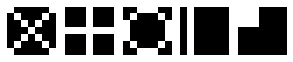

with probabilities:
[0.20 0.20 0.20 0.20 0.20]



 --- Iter #0 --- 
Neurons' weights:


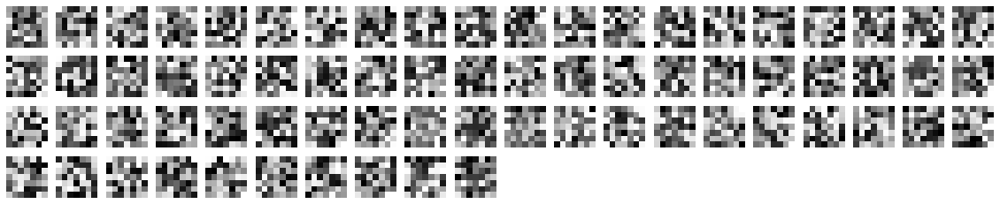

Layer outputs:
[0.71 0.78 0.62 0.73 0.65 0.62 0.69 0.78 0.71 0.72 0.79 0.84 0.62 0.75
 0.83 0.67 0.74 0.73 0.65 0.69 0.60 0.78 0.65 0.74 0.68 0.70 0.64 0.79
 0.67 0.79 0.70 0.82 0.82 0.64 0.74 0.73 0.69 0.71 0.76 0.59 0.78 0.67
 0.67 0.73 0.78 0.65 0.80 0.98 0.78 1.00 0.80 0.56 0.88 0.85 0.64 0.73
 0.79 0.60 0.71 0.86 0.69 0.65 0.74 0.74 0.73 0.73 0.70 0.75 0.68 0.88]

 --- Iter #200 --- 
Neurons' weights:


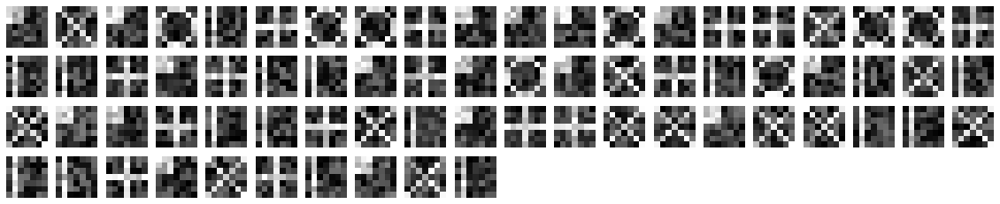

Layer outputs:
[0.14 0.12 0.13 0.12 0.14 0.71 0.12 0.12 0.74 0.14 0.13 0.10 0.13 0.13
 0.76 0.83 0.12 0.13 0.13 0.63 0.15 0.17 0.75 0.13 0.64 0.16 0.13 0.13
 0.74 0.13 0.12 0.13 0.11 0.75 0.16 0.13 0.14 0.16 0.12 0.15 0.12 0.13
 0.13 0.83 0.16 0.15 0.71 0.11 0.16 0.12 1.00 0.60 0.11 0.11 0.13 0.11
 0.12 0.15 0.15 0.11 0.15 0.13 0.77 0.13 0.12 0.69 0.14 0.12 0.12 0.15]

 --- Iter #400 --- 
Neurons' weights:


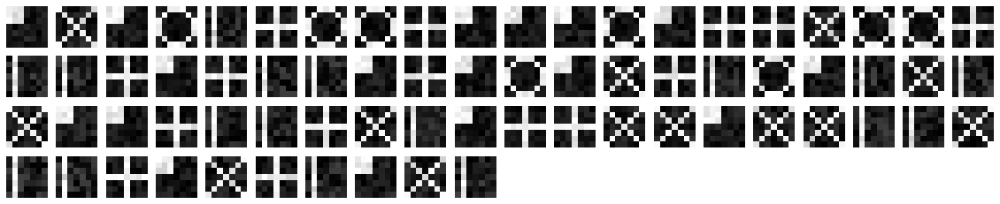

Layer outputs:
[0.04 0.79 0.04 0.03 0.04 0.02 0.03 0.03 0.02 0.04 0.04 0.04 0.03 0.04
 0.02 0.02 0.75 0.03 0.03 0.03 0.04 0.04 0.02 0.04 0.02 0.04 0.04 0.04
 0.02 0.04 0.03 0.04 0.84 0.02 0.04 0.03 0.04 0.04 0.78 0.04 0.80 0.04
 0.04 0.02 0.04 0.04 0.03 1.00 0.04 0.04 0.02 0.02 0.89 0.86 0.04 0.74
 0.81 0.04 0.04 0.87 0.04 0.04 0.02 0.04 0.74 0.02 0.04 0.04 0.69 0.04]

 --- Iter #600 --- 
Neurons' weights:


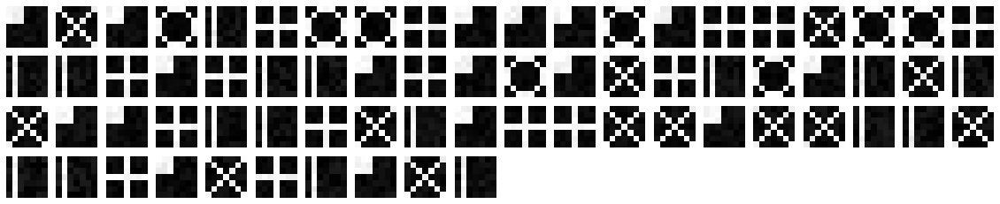

Layer outputs:
[0.00 0.00 0.00 0.84 0.00 0.00 0.71 1.00 0.00 0.00 0.00 0.00 0.83 0.00
 0.00 0.00 0.00 0.89 0.80 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00
 0.00 0.00 0.75 0.00 0.00 0.00 0.00 0.83 0.00 0.00 0.00 0.00 0.00 0.00
 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00
 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00]

 --- Iter #800 --- 
Neurons' weights:


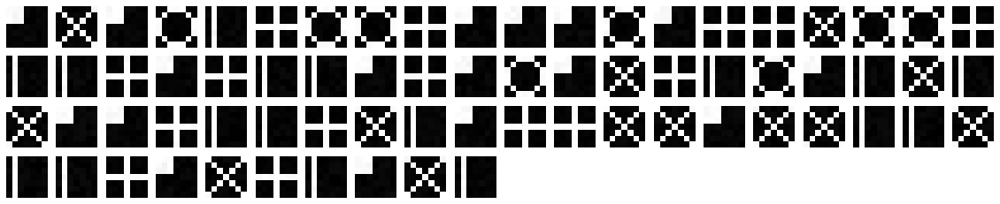

Layer outputs:
[0.00 0.79 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00
 0.00 0.00 0.75 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00 0.00
 0.00 0.00 0.00 0.00 0.84 0.00 0.00 0.00 0.00 0.00 0.78 0.00 0.80 0.00
 0.00 0.00 0.00 0.00 0.00 1.00 0.00 0.00 0.00 0.00 0.89 0.86 0.00 0.74
 0.81 0.00 0.00 0.87 0.00 0.00 0.00 0.00 0.74 0.00 0.00 0.00 0.69 0.00]


In [118]:
ITERS = 1000 # 50000
NEURONS = 70
DRAW_INTERVAL = 200 # 2000
VERBOSE=False

layer = FastLayer(DIMS[0]*DIMS[1], NEURONS)

print("\n----------------\nRunning frontprop on following patterns:")
plot_matrix(DIMS, *patterns)
print(f"with probabilities:\n{probs}\n\n")

for i in range(ITERS):

    input_idx = np.random.choice(len(probs), p=probs)
    input = patterns[input_idx].flatten()
    
    if VERBOSE:
        print(f"Iter #{i}: Feeding input pattern #{input_idx}")
        print(input)
        plot_matrix(input)
        
    out = layer.forward(input)
    
    if i % DRAW_INTERVAL == 0:
        print(f"\n --- Iter #{i} --- ")
        layer.draw(DIMS)
        print("Layer outputs:")
        print(out)
        

## MNIST

In [137]:
import torchvision
import torchvision.datasets as datasets

mnist_trainset = datasets.MNIST(root='./data', train=True, download=True, transform=None)

mnist_data = mnist_trainset.train_data.cpu().detach().numpy()
# normalise to 0-1
mnist_data = mnist_data / 256.0

mnist_labels = mnist_trainset.train_labels.cpu().detach().numpy()

/usr/local/Cellar/jupyterlab/3.3.2/libexec/lib/python3.9/site-packages/torchvision/datasets/mnist.py:75: UserWarning: train_data has been renamed data
  warnings.warn("train_data has been renamed data")
/usr/local/Cellar/jupyterlab/3.3.2/libexec/lib/python3.9/site-packages/torchvision/datasets/mnist.py:65: UserWarning: train_labels has been renamed targets
  warnings.warn("train_labels has been renamed targets")



----------------
Running frontprop on MNIST


  0%|                                                                                                                                                | 0/60000 [00:00<?, ?it/s]


 --- Iter #0 --- 
Neurons' weights:


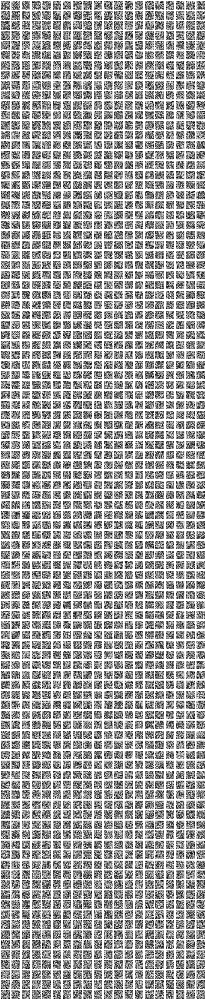

  0%|                                                                                                                                    | 5/60000 [01:00<150:36:37,  9.04s/it]

Layer1 outputs:
[0.87 0.92 0.88 ... 0.87 0.88 0.88]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 60000/60000 [25:49<00:00, 38.71it/s]


In [132]:
ITERS = 60000
NEURONS = 2000
THRESHOLD_DECAY=0.0001
WEIGHT_BOOST=0.01

DIMS = [28, 28]
VERBOSE = False
DRAW_INTERVAL = 60000

layer1 = FastLayer(DIMS[0]*DIMS[1], NEURONS, THRESHOLD_DECAY, WEIGHT_BOOST)

print("\n----------------\nRunning frontprop on MNIST")

indices = np.arange(mnist_data.shape[0])
np.random.shuffle(indices)
for i, input_idx in enumerate(tqdm(indices)):
    
    # normalise to 0-1
    input1 = mnist_data[input_idx].flatten()
          
    out1 = layer1.forward(input1)
    
    if i % DRAW_INTERVAL == 0:
        print(f"\n --- Iter #{i} --- ")
        layer1.draw(DIMS)
    
        print("Layer1 outputs:")
        print(out1)


Neurons' weights:


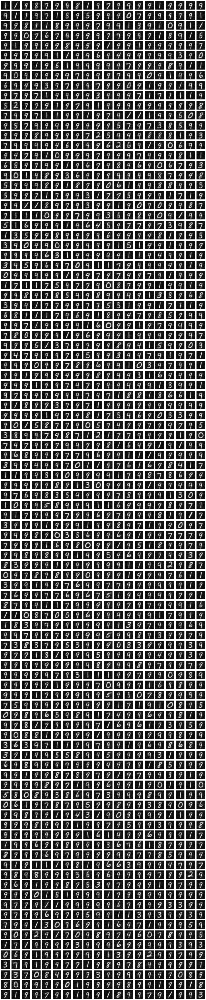

In [136]:
layer1.draw(DIMS)

## TEST

### PCA
Use PCA to visualise whether the network outputs cluster well, for some randomly chosen test data.

In [138]:
# Get network outputs for bunch of samples 

TEST_SET_SIZE=6000

# layer outputs for mnist samples
X = []
# labels
y = []

layer1.freeze()
#layer1.draw()

for i in tqdm(range(TEST_SET_SIZE)):
    sample_idx = np.random.randint(0, len(mnist_data))
    digit = mnist_labels[sample_idx]
    features = mnist_data[sample_idx].flatten()
            
    output = layer1.forward(features)
    
    X.append(output)
    y.append(digit)
    
layer1.unfreeze()

Freezing all 2000 neurons


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6000/6000 [00:59<00:00, 100.95it/s]

Unfreezing all 2000 neurons


In [139]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn import metrics

pca = PCA(n_components=2)

pca_features = pca.fit_transform(X)



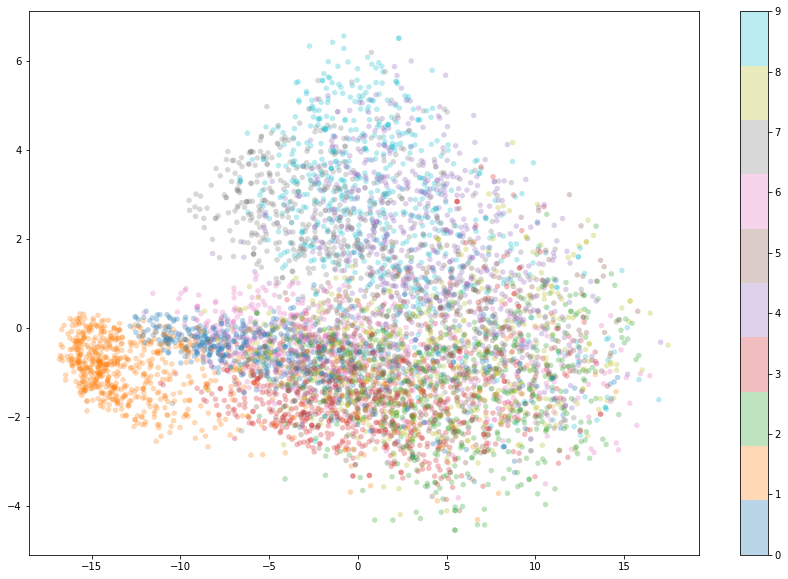

In [140]:
plt.figure(figsize=(15,10))
plt.scatter(pca_features[:, 0], pca_features[:, 1],
            c=y, edgecolor='none', alpha=0.3,
            cmap=plt.cm.get_cmap('tab10', 10), s=30)
# plt.xlabel('component 1')
# plt.ylabel('component 2')
plt.colorbar();
plt.show()


## KNN
TODO:
Cluster outputs using KNN, similarly to PCA above.


### Log Reg

This is similar to the benchmark used in Geoffrey Hinton's paper ("forward-forward", see [here](https://www.cs.toronto.edu/~hinton/FFA13.pdf)).
Treat outputs as embeddings and train a simple multi-class Log Reg on them.

Results can then be compared with other self-supervised networks, incl the "forward-forward" above.

In [133]:
# first collect outputs for all MNIST samples

layer1.freeze()
# layer1.draw()

mnist_embeddings = np.array([layer1.forward(sample.flatten()) for sample in tqdm(mnist_data)])
print(mnist_embeddings.shape)
    
layer1.unfreeze()

Freezing all 2000 neurons


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 60000/60000 [07:21<00:00, 135.83it/s]


(60000, 2000)
Unfreezing all 2000 neurons


In [134]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

mnist_train, mnist_test, mnist_train_labels, mnist_test_labels = train_test_split(
    mnist_embeddings, mnist_labels, test_size=0.1, random_state=0)

logReg = LogisticRegression(solver = 'lbfgs') # multi_class="multinomial"

logReg.fit(mnist_train, mnist_train_labels)

score = logReg.score(mnist_test, mnist_test_labels)
print(score)

0.6093333333333333
